# Final project for HDEq Skills: 
`Due: Friday 1st December 2023 @ 12:00 (noon)`

## Instruction and marking scheme

Your submission (like your assignments) will be a Jupyter Notebook (.ipynb file) and a pdf file.  For your analysis and discussion use Markdown cells instead of comments in the code.

For the presentation and coding style:
- The plots should be in a good size, properly labelled and markers/lines wisely chosen. It might be a good idea to combine some plots and put several curves together for easier comparison and conciseness. 
- Your code should be well commented with meaningful variable names and good structures. You don't need to over comment it though!
- The writing should be clear and concise with minimal language or typing mistakes.


It is important that you think about good academic practice when you construct your answers. The work you submit must reflect **your own understanding**, in line with the School's policy on academic misconduct: https://edin.ac/2LtVQMw. Any form of plagiarism that is detected by the software or markers will be reported to the school for the due process.

## Part 1: Wave equation with linear damping

Consider the following wave equation that includes a damping term

<br>
\begin{equation}
u_{tt} + \nu u_{t} = c^2 u_{xx}
\end{equation}
<br>
with the boundary conditions
\begin{equation}
u\left(x = 0, t\right) = 0 , \quad u\left(x = L, t\right) = 0,
\end{equation}
and the initial conditions
\begin{equation*}
u\left(x, t=0\right) = f(x) = \exp\left(\sin^2\left(\frac{2\pi x}{L}\right)\right)-1 , \quad u_t\left(x, t=0\right) = 0,
\end{equation*}

For this problem, let's set $L=10$, $\nu = 0.1$ and $c = 1$.

We use a method to solve this PDE that is known as "Galerkin". In so doing, we approximate the solution with

\begin{equation*}
u(x, t) \approx \sum_{n=1}^{N} f_n(t) \sin(\lambda_n x) 
\end{equation*}

and then derive an appropriate ODE for $f_n(t)$ to solve numerically. This is a form of separation of variables in which the equations for the functions of time are solved numerically rather than by hand. It can be shown that when $N \to \infty$ the above series converges to the exact solution. 

🚩 **Task 1.1 (1 mark)** Considering the above form of solution, find $\lambda_n$ in terms of $n$ and $L$. 

🚩 **Task 1.2 (1 mark)** Using the assumed form of solution and PDE, find an ODE that describes the evolution of $f_n(t)$ in time, (where $n = 1, 2, \dots, N $).

🚩 **Task 1.3 (2 marks)** Using the initial conditions of the PDE and your knowledge of Fourier series, find two initial conditions for $f_n$ and $\cfrac{df_n}{dt}$ at $t=0$. Your answer in this part might in the form of an integral, which you should not evaluate at this point (we will calculate this integral later numerically).

---------------
*use this cell for your answer*

## Answer


✏️ **Task 1.1 (1 mark)** 

$\lambda_n = \frac{n\pi}{L}$

✏️ **Task 1.2 (1 mark)** 

$vf'_n + f''_n = -\lambda_n^2 f_n$

✏️ **Task 1.3 (2 marks)** 

$f'_n(0) = 0$

$f_n(0) = \frac{2}{L} \int_0^L f(x) \sin(\lambda_n x) dx$

Note, we approximate $f(x)$ as its odd extension.



🚩 **Task 1.4 (3 marks)** Write a function that takes $n$ (the index of the terms in the series solution, for example $n=3$ corresponds to $f_3(0)$) as an input and returns $f_n(0)$. You might solve this part using different tools: 1) `sympy` module or 2) direct numerical calculation using  `scipy.integrate` (see the documentation [here](https://docs.scipy.org/doc/scipy/reference/tutorial/integrate.html)). Make sure your final result is a numerical real value (not symbolic expressions). Remember from your labs that you can use `.N()` method to evaluate a sympy expression (if you decide to use `sympy`, which is not the only way to complete this task).

Once you have written your function, use it to calculate $f_n(0)$ for $L=10$, $n=5$ and the given initial condition $u(x, t=0) = \exp\left(\sin^2\left(\frac{2\pi x}{L}\right)\right)-1$.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import pandas as pd
import sympy as sym
from scipy import integrate
sym.init_printing()

L = 10

def f(x):
   """
   Our initial condition u(x,0) = f(x)
   """
   return np.exp((np.sin(2*np.pi*x/L))**2)-1

def calc_fn_0(k):
   # it is easy to show that f_n(0) = 0 for even n
   if (k%2 == 0):
      return 0
   L = 10 # the global variable
   
   #approximate f as its odd extension
   weight = 2
   function = lambda x: f(x)*np.sin(k*np.pi*x/L)
   return weight*integrate.quad(function,0,L)[0]/L

print("f_5(0) = ", calc_fn_0(5))
print("The initial condition is that f'_5(0) = 0 and f_5(0) = {:.4f} ".format(calc_fn_0(5)))

f_5(0) =  -0.4264022028513228
The initial condition is that f'_5(0) = 0 and f_5(0) = -0.4264 


🚩 **Task 1.5 (4 marks)** Write a function to solve the ODEs that you derived in 'Task 1.2' for each $f_n(t)$. Your function takes $n$ (the index of terms in the solution series) and `t_vec` (the vector of times at which you want to have the solution). Then, it calculates the corresponding initial conditions ($f_n$ and $\cfrac{df}{dt}$ at $t=0$), solves the associated ODE and returns the solution at each point in `t_vec`. Use `odeint` to solve the ODE numerically. You may also use the function you wrote in the previous task.

Use the function to plot $f_1(t)$, $f_2(t)$ and $f_3(t)$ for `t_vec = np.linspace(0, 100, 1001)`.

In [2]:
import matplotlib.pyplot as plt
from scipy.integrate import odeint
# and this is the line in case the figure does not show up!
%matplotlib inline

nu = 0.1
c = 1
L = 10
    
def dF_dt(F, t, k):
    '''
    this function defines the RHS of the system of ODEs for f_n's
    Auxiliary function for odeint
    ----------------------'------------------------------
    output:
    dF_dt = [df/dt, dg/dt] 
    where f = f_k(t) and g = df/dt
    '''
    f, g = F
    lambda_k = (k*np.pi/L)
    return [g, -nu*g-lambda_k**2*f]

    
def fn_solve(k, t_vec):
    '''
    This function derives the solution of f_k(t) for all the times in 't_vec'
    'k' is given as an input and marks the index of the term in series solution 
    '''

    # initial condition
    F0 = [calc_fn_0(k), 0] 
    # solve the system of ODEs
    Fs = odeint(dF_dt, F0, t_vec, args=(k,))
    # return the solution of f_k(t)
    return Fs[:,0]

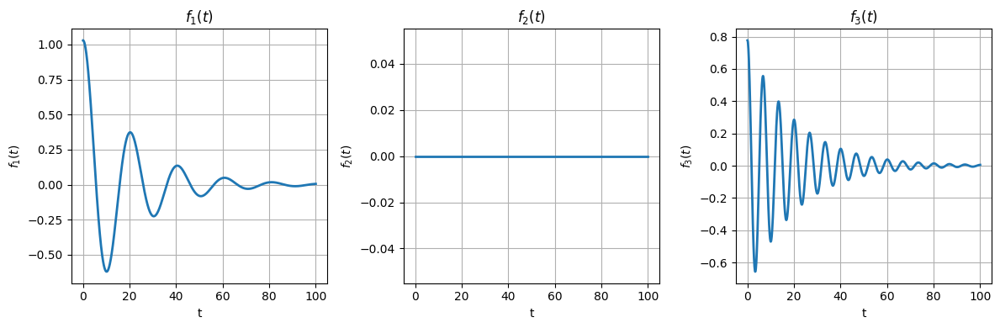

In [3]:
# plot f_1(t), f_2(t), f_3(t) in three different subplots
t_vec = np.linspace(0, 100, 1001)
fig, ax = plt.subplots(1, 3, figsize=(12, 4))
for k in range(1, 4):
    ax[k-1].plot(t_vec, fn_solve(k, t_vec), lw=2)
    ax[k-1].set_xlabel('t')
    ax[k-1].set_ylabel('$f_{}(t)$'.format(k))
    ax[k-1].set_title('$f_{}(t)$'.format(k))
    ax[k-1].grid(True)
plt.tight_layout()



🚩 **Task 1.6 (4 marks)** Write a function that takes $N$ (the total number of terms in the sine series of the solution), `t_vec` and `x_vec` (which is the vector of points in space) as inputs and returns the solution $u(x,t)$ of the PDE at the times `t_vec` and points `x_vec`. Your function output should be a $N_T \times N_X$ numpy array, where $N_T$ is the number of points in time (i.e. the size of `t_vec`) and  $N_X$ is the number of points in space (i.e. the size of `x_vec`). Make good use of the functions you already wrote in the previous tasks.

With this function, find the solution for 

`x_vec = np.linspace(0, L, 201)`

`t_vec = np.linspace(0, 100, 1001)` 

`N =7`

Make an animation to show how $u(x,t)$ changes in time (each frame of animation is the solution at all spatial points but for one specific point in time)

In [4]:
def waveq_dam_solve(N, t_vec, x_vec):
    '''
    This function derives the solution of the wave equation with damping
    'N' is given as an input and marks the number of terms in series solution 
    '''
    # initialize the solution matrix
    u = np.zeros((len(t_vec), len(x_vec)))
    # loop over the terms in the series
    for k in range(1,N+1):
        # derive the solution of f_k(t)
        f_k = fn_solve(k, t_vec)
        # derive the solution of the wave equation with damping
        u += f_k.reshape(-1,1)*np.sin(k*np.pi*x_vec/L)
    return u



# define the time vector
t_vec = np.linspace(0, 100, 1001)
# define the space vector
x_vec = np.linspace(0, L, 201)


Text(0.5, 1.0, 'Approx. solution at t=0 vs. initial condition')

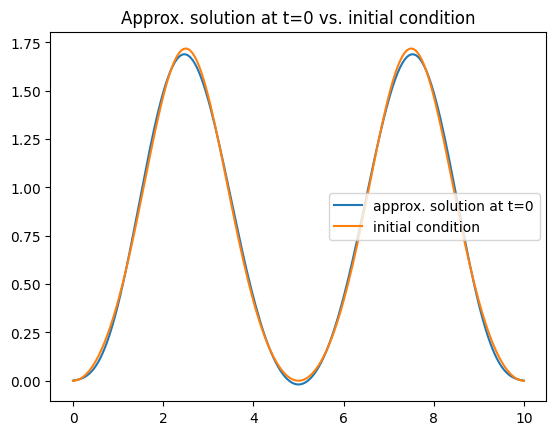

In [5]:
# Assuming the PDE's solution is stored in u_x_t[:,:],
# compare the approx. solution at t=0 with the initial condition

u_x_t = waveq_dam_solve(7, t_vec, x_vec)

plt.plot(x_vec, u_x_t[0,:], label="approx. solution at t=0")
plt.plot(x_vec,np.exp((np.sin(2*np.pi*x_vec/L))**2)-1, label="initial condition")
plt.legend()
plt.title('Approx. solution at t=0 vs. initial condition')

In [6]:
#the full animation was too large to be displayed inline, as warned by the jupyter notebook
#thus only part of the animation was shown

import matplotlib.animation as animation
import numpy as np
import matplotlib.animation as animation
import sympy as sym
from IPython.display import HTML

# define the time vector
t_vec = np.linspace(0, 100, 1001)
# define the space vector
x_vec = np.linspace(0, L, 201)
# derive the solution of the wave equation with damping
u = waveq_dam_solve(7, t_vec, x_vec)

fps = 50
t_max = 100
# make an animation
fig, ax = plt.subplots()
plt.plot(x_vec,np.exp((np.sin(2*np.pi*x_vec/L))**2)-1, 'r:', label='Initial condition')
plt.ylim([-2, 2])
plt.xlabel('x')
plt.ylabel('u(x,t)')
plt.title("Animation of the solution of the wave equation with damping With N=7")
line, = ax.plot([], [], lw=2, label='Solution')
plt.legend()
txt = ax.text(0, 0.9, 't=0')
plt.close()

def init():
    line.set_data([], [])
    return (line,)

def animate(i):
    line.set_data(x_vec, u[i,:])
    txt.set_text('t={}'.format(t_vec[i].round(2)))
    return (line,)

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=t_vec.size//4, interval=1000/fps, blit=True)
HTML(anim.to_jshtml())


🚩 **Task 1.7 (2 marks)** Examine how the solution changes for different values of $N$. Consider $N=3$, $N=7$ and $N=11$. Show the animation of the solution for all the three cases in one plot and compare them with each other. Discuss and analyse your results (for example, are three terms enough to get an acceptable solution? What about seven?)

In [7]:
#the full animation was too large to be displayed inline, as warned by the jupyter notebook
#thus only part of the animation was shown

#calculating solutions for N=3,7,11
u_3 = waveq_dam_solve(3, t_vec, x_vec)
u_7 = waveq_dam_solve(7, t_vec, x_vec)
u_11 = waveq_dam_solve(11, t_vec, x_vec)

#plotting
fig, ax = plt.subplots()
plt.plot(x_vec,np.exp((np.sin(2*np.pi*x_vec/L))**2)-1, 'r:', label='Initial condition')
plt.ylim([-2, 2])
plt.xlabel('x')
plt.ylabel('u(x,t)')
plt.title("Animation of the solution of the wave equation with damping \n Note N=7, N=11 overlaps")
line3, = ax.plot([], [], lw=2, label='N=3', alpha=0.5)
line7, = ax.plot([], [], lw=2, label='N=7', alpha=0.5)
line11, = ax.plot([], [], lw=2, label='N=11', alpha=0.5)
plt.legend()
txt = ax.text(0, 0.9, 't=0')
plt.close()

def init():
    line3.set_data([], [])
    line7.set_data([], [])
    line11.set_data([], [])
    return (line, line3, line7, line11)

def animate(i):
    line3.set_data(x_vec, u_3[i,:])
    line7.set_data(x_vec, u_7[i,:])
    line11.set_data(x_vec, u_11[i,:])
    txt.set_text('t={}'.format(t_vec[i].round(2)))
    return (line, line3, line7, line11)

anim = animation.FuncAnimation(fig, animate, init_func=init,
                                 frames=t_vec.size//4, interval=1000/fps, blit=True)
HTML(anim.to_jshtml())

## task 1.7
It does not seem like $N=3$ is a good approximation. The solution at $t=0$ deviates from the initial condition by large.

$N=7$ seems to be a good approximation. The solution at $t=0$ is very close to the initial condition.

Moreover, there is little difference between the solutions for $N=7$ and $N=11$.

🚩 **Task 1.8 (1 marks)** Change the damping parameter to $\nu = 1$, and repeat the 'task 1.6' (for $N=7$ and keep all other parameters the same). In few sentences, explain the changes caused by increasing the damping.

In [22]:
import matplotlib.pyplot as plt
from scipy.integrate import odeint
# and this is the line in case the figure does not show up!
%matplotlib inline

nu = 1
c = 1
L = 10
    
def dF_dt(F, t, k):
    '''
    this function defines the RHS of the system of ODEs for f_n's
    Auxiliary function for odeint
    ----------------------'------------------------------
    output:
    dF_dt = [df/dt, dg/dt] 
    where f = f_k(t) and g = df/dt
    '''
    f, g = F
    lambda_k = (k*np.pi/L)
    return [g, -nu*g-lambda_k**2*f]

    
def fn_solve(k, t_vec):
    '''
    This function derives the solution of f_k(t) for all the times in 't_vec'
    'k' is given as an input and marks the index of the term in series solution 
    '''

    # initial condition
    F0 = [calc_fn_0(k), 0] 
    # solve the system of ODEs
    Fs = odeint(dF_dt, F0, t_vec, args=(k,))
    # return the solution of f_k(t)
    return Fs[:,0]

def waveq_dam_solve(N, t_vec, x_vec):
    '''
    This function derives the solution of the wave equation with damping
    'N' is given as an input and marks the number of terms in series solution 
    '''
    # initialize the solution matrix
    u = np.zeros((len(t_vec), len(x_vec)))
    # loop over the terms in the series
    for k in range(1,N+1):
        # derive the solution of f_k(t)
        f_k = fn_solve(k, t_vec)
        # derive the solution of the wave equation with damping
        u += f_k.reshape(-1,1)*np.sin(k*np.pi*x_vec/L)
    return u



# define the time vector
t_vec = np.linspace(0, 100, 1001)
# define the space vector
x_vec = np.linspace(0, L, 201)

u = waveq_dam_solve(7, t_vec, x_vec)

fps = 20
t_max = 100
# make an animation
fig, ax = plt.subplots()
plt.plot(x_vec,np.exp((np.sin(2*np.pi*x_vec/L))**2)-1, 'r:', label='Initial condition')
plt.ylim([-2, 2])
plt.xlabel('x')
plt.ylabel('u(x,t)')
plt.title("With N=7 and damping coefficient = 1")
line, = ax.plot([], [], lw=2, label='Solution')
plt.legend()
txt = ax.text(0, 0.9, 't=0')
plt.close()

def init():
    line.set_data([], [])
    return (line,)

def animate(i):
    line.set_data(x_vec, u[i,:])
    txt.set_text('t={}'.format(t_vec[i].round(2)))
    return (line,)

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=t_vec.size//4, interval=1000/fps, blit=True)

HTML(anim.to_jshtml())

#the full animation was too large to be displayed inline, as warned by the jupyter notebook
#thus only part of the animation was shown

## task 1.9 markdown answer
It seems like the larger the damping parameter, the faster the solution converges to zero. This fits our physical interpretation, as damping is a mechanism that dissipates energy. Thus, the larger the damping parameter, the faster the energy dissipates and the faster the waves die out.

## Part 2: Lorenz system


The Lorenz system is given by the coupled set of ODEs
\begin{equation}
  \frac{\mathrm{d}x}{\mathrm{d}t} = -\sigma x + \sigma y, \qquad
  \frac{\mathrm{d}y}{\mathrm{d}t} = x(\rho - z) - y, \qquad
  \frac{\mathrm{d}z}{\mathrm{d}t} = xy - \beta z,
\end{equation}
where ($\rho, \sigma, \beta$) are system parameters. Lorenz derived these equation as a simplified mathematical model for [atmospheric convection](https://en.wikipedia.org/wiki/Atmospheric_convection), which is an aspect of weather.  While the Lorenz system is deterministic, you will find in this problem that in certain sets of parameters there is sensitive dependence of the solution on the initial condition. Assuming this system is a representation of weather, small errors invariably arise (e.g. numerical discretisation, measurements inaccuracy), grow and affect long term solutions (cf. loss of predictability in weather forecasting). However, there are statistical properties (cf. the climatology) that may be robust and may be described accordingly.

--------------------
### Case of stable solution


Consider the parameters $\sigma = 8$, $\beta = 2$ and $\rho = 12$.


🚩 **Task 2.1 (1 mark)** Find all the critical points of this system.

🚩 **Task 2.2 (2 marks)** Using a numerical method of your choice, find the solution starting from $x(t=0) = y(t=0) = z(t=0) = 10$ up to $t=20$. Plot the solution in *x-y*, *y-z* and *x-z* planes (so you need three plots). Where does this initial condition end up in? Can you express the exact location of this solution as $t \to \infty$? Make sure your timestep is small enough to have robust results. You can check this by running your code for several different timesteps.

## Answer

✏️ **Task 2.1 (1 mark)**

The critical points are $(0,0,0)$, $(\sqrt{\beta(\rho-1)},\sqrt{\beta(\rho-1)},\rho-1)$, and $(-\sqrt{\beta(\rho-1)},-\sqrt{\beta(\rho-1)},\rho-1)$

evaluate with given parameters, we have $(0,0,0)$, $(\sqrt{22}, \sqrt{22}, 11)$, and $(-\sqrt{22}, -\sqrt{22}, 11)$, which equals approximately $(0,0,0)$, $(4.69, 4.69, 11)$, and $(-4.69, -4.69, 11)$

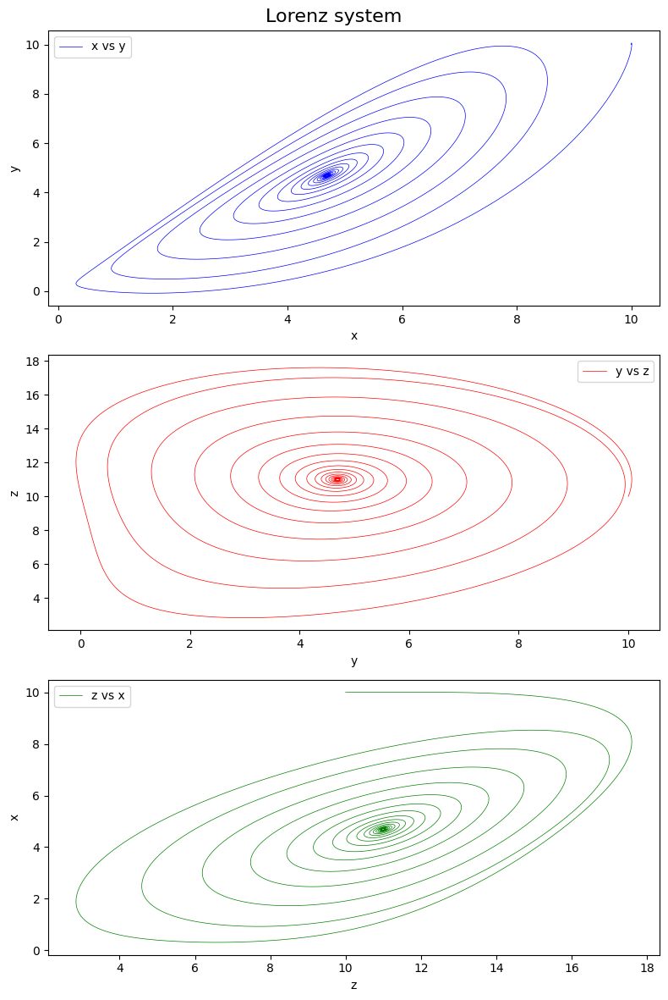

In [9]:
# Task 2.2
import numpy as np
from scipy.integrate import odeint
import matplotlib.pyplot as plt


rho = 12.0
sigma = 8.0
beta = 2.

def lorenz(w, t, rho, sigma, beta):
    x, y, z = w
    return np.array([sigma*(y-x), x*(rho-z)-y, x*y-beta*z])

t = np.linspace(0, 20, 10000)
track = odeint(lorenz, (10, 10, 10), t, args=(rho, sigma, beta))

# create 3 subplot, and plot x vs y, y vs z, z vs x respectively

fig, ax = plt.subplots(3, 1, figsize=(8, 12))

fig.suptitle('Lorenz system', fontsize=16)

ax[0].plot(track[:, 0], track[:, 1], 'b-', lw=0.5, label='x vs y')
ax[0].set_xlabel('x')
ax[0].set_ylabel('y')
ax[0].legend()

ax[1].plot(track[:, 1], track[:, 2], 'r-', lw=0.5, label='y vs z')
ax[1].set_xlabel('y')
ax[1].set_ylabel('z')
ax[1].legend()

ax[2].plot(track[:, 2], track[:, 0], 'g-', lw=0.5, label='z vs x')
ax[2].set_xlabel('z')
ax[2].set_ylabel('x')
ax[2].legend()

plt.tight_layout()
plt.show()



## Task 2.2 

It is unsurprising that the solution is approaching the critical point $\sqrt{22}, \sqrt{22}, 11$, as the initial condition is close to this critical point.


🚩 **Task 2.3 (4 marks)** Consider two different numerical methods: forward Euler and Ruge-kutta (4th order) methods. Set the initial condition to $x = y = z = 100$ and the final time to 0.3. The Ruge-kutta method with timestep h=10^{-6} is accurate enough that **we can regard it as an exact solution**. Using this *estimate numerically* the **global error** for variable $x$ and plot it in log-scale as a function of timestep. In so doing, consider the values `[0.002, 0.001, .0005, 0.0002, 0.0001]` for timesteps. 

Note that the order of error can be estimated from the slope of plots in log-scales. If a function is proportional to $h^{6}$, then in log-scale it looks linear and have the slope of $6$.

What is the slope of global error vs timestep for each method? Why do you get these slopes? You can estimate the slopes by drawing linear guidelines. For example, if you draw $h^{6}$ and your curve is close to this guideline, then you can conclude that the slope is close to $6$. You need to shift your guidelines up and down to bring them closer to the results of numerical solutions. Are the results different than the slopes you expect for the local error as a function of timestep? Can you reason why?


(Remember that you have already implemented forward Euler and Ruge-kutta in your lab notebooks. There is also something called "copy-paste".)

In [10]:
import numpy as np
import math 

def ode_RK4(func,times,y0):
    '''
    integrates the system of y' = func(y, t) using Runge-Kutta 4th order
    for the time steps in times and given initial condition y0
    ----------------------------------------------------------
    inputs:
        func: the RHS function in the system of ODE
        times: the points in time (or the span of independent variable in ODE)
        y0: initial condition (make sure the dimension of y0 and func are the same)
    output:
        y: the solution of ODE. 
        Each row in the solution array y corresponds to a value returned in column vector t
    '''
    times = np.array(times)
    y0 = np.array(y0)
    n = y0.size       # the dimension of ODE 
    nT = times.size   # the number of time steps 
    y = np.zeros([nT,n])
    y[0, :] = y0
    for k in range(nT-1):
        dt = times[k+1] - times[k]
        f1 = func(y[k,:], times[k])
        f2 = func(y[k,:] + 0.5*dt*f1, times[k] + 0.5*dt)
        f3 = func(y[k,:] + 0.5*dt*f2, times[k] + 0.5*dt)
        f4 = func(y[k,:] + dt*f3, times[k] + dt)
        y[k+1,:] = y[k,:]+dt/6*(f1+2*f2+2*f3+f4)
    return y 

# Euler scheme
def ode_Euler(func, times, y0):
    '''
    integrates the system of y' = func(y, t) using forward Euler method
    for the time steps in times and given initial condition y0
    ----------------------------------------------------------
    inputs:
        func: the RHS function in the system of ODE
        times: the points in time (or the span of independent variable in ODE)
        y0: initial condition (make sure the dimension of y0 and func are the same)
    output:
        y: the solution of ODE. 
        Each row in the solution array y corresponds to a value returned in column vector t
    '''
    # guess why I put these two lines here?
    times = np.array(times)
    y0 = np.array(y0)
    n = y0.size       # the dimension of ODE 
    nT = times.size   # the number of time steps 
    y = np.zeros([nT,n])
    y[0, :] = y0
    # loop for timesteps
    for k in range(nT-1):
        y[k+1, :] = y[k, :] + (times[k+1]-times[k])*func(y[k, :], times[k])
    return y

import math
def timesteps(start, stop, h):
    num_steps = math.ceil((stop - start)/h)
    return np.linspace(start, start+num_steps*h, num_steps+1)


def Euler_step(func, start, stop, h, ics):
    times = timesteps(start, stop, h)
    values = ode_Euler(func, times, ics)
    return values, times

def RK4_step(func, start, stop, h, ics):
    times = timesteps(start, stop, h)
    values = ode_RK4(func, times, ics)
    return values, times
### END SOLUTION

In [11]:
sigma = 8
rho = 12
beta = 2

def lorenz(y, t):
    x, y, z = y
    return np.array([sigma*(y-x), x*(rho-z)-y, x*y-beta*z])

timestep = [0.002, 0.001, 0.0005, 0.0002, 0.0001]
ics = [100, 100, 100]
t_start = 0
t_final = 0.3 
exact, x_vec = RK4_step(lorenz, t_start, t_final, 10**(-6), ics)

In [12]:
import scipy 

sigma = 8
rho = 12
beta = 2
t_start = 0
t_final = 0.3 

timestep = [0.002, 0.001, 0.0005, 0.0002, 0.0001]

eular_error = []
RK4_error = []

for i in timestep:
    approx, _= Euler_step(lorenz, t_start, t_final, i, ics)
    # find the error of the last point
    eular_error.append(np.linalg.norm(exact[-1] - approx[-1]))
    approx, _ = RK4_step(lorenz, t_start, t_final, i, ics)
    # find the error of the last point
    RK4_error.append(np.linalg.norm(exact[-1] - approx[-1]))


# find the best fit line to help us determine the order of convergence
eular_fit_slope, eular_fit_intercept, eular_fit_r_value, eular_fit_p_value, eular_fit_std_err = scipy.stats.linregress(np.log(timestep),np.log(eular_error))
RK4_fit_slope, RK4_fit_intercept, RK4_fit_r_value, RK4_fit_p_value, RK4_fit_std_err = scipy.stats.linregress(np.log(timestep), np.log(RK4_error))


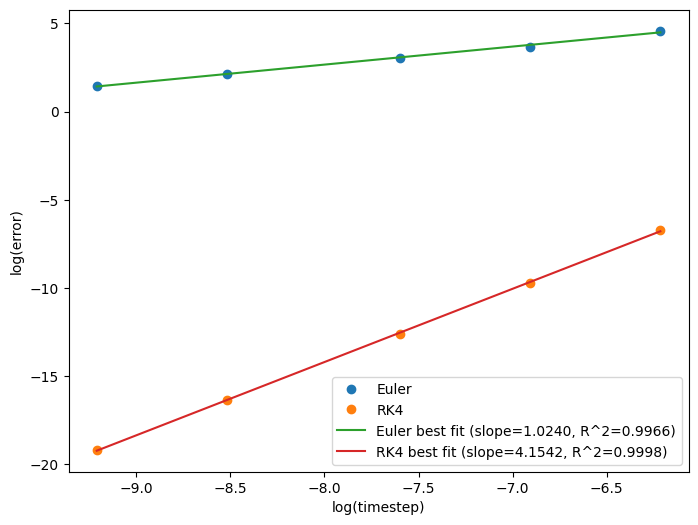

The order of Euler method is 1.024
i.e., the error of Euler method is respect to timestep h is approximately O(h^1.024)
this means, error is approximately proportional to h^1.024
The order of RK4 method is 4.1542
i.e., the error of RK4 method is respect to timestep h is approximately O(h^4.1542)
this means, error is approximately proportional to h^4.1542


In [13]:
# plot the error vs timestep
plt.figure(figsize=(8, 6))
plt.plot(np.log(timestep), np.log(eular_error), 'o', label='Euler')
plt.plot(np.log(timestep), np.log(RK4_error), 'o', label='RK4')
plt.plot(np.log(timestep), np.polyval((eular_fit_slope, eular_fit_intercept), np.log(timestep)), 
         label='Euler best fit (slope={:.4f}, R^2={:.4f})'.format(eular_fit_slope, eular_fit_r_value**2))
plt.plot(np.log(timestep), np.polyval((RK4_fit_slope, RK4_fit_intercept), np.log(timestep)), 
        label='RK4 best fit (slope={:.4f}, R^2={:.4f})'.format(RK4_fit_slope, RK4_fit_r_value**2))
plt.xlabel('log(timestep)')
plt.ylabel('log(error)')
plt.legend()
plt.show()


#the slope of the best fit line is the order of the method
print('The order of Euler method is', eular_fit_slope.round(4))
print('i.e., the error of Euler method is respect to timestep h is approximately O(h^{})'.format(eular_fit_slope.round(4)))
print('this means, error is approximately proportional to h^{}'.format(eular_fit_slope.round(4)))
print('The order of RK4 method is', RK4_fit_slope.round(4))
print('i.e., the error of RK4 method is respect to timestep h is approximately O(h^{})'.format(RK4_fit_slope.round(4)))
print('this means, error is approximately proportional to h^{}'.format(RK4_fit_slope.round(4)))

## Task 2.3 

The slope of global error vs timestep for forward Euler is approximately 1. The slope of global error vs timestep for Ruge-kutta is approximately 4. This is because the global error is the sum of local errors, and the local error for forward Euler is proportional to $h$, while the local error for Ruge-kutta is proportional to $h^4$.

We have $R^2$ value surprisingly close to one, indicating our conclusion on the rate of convergence is likely to be true.

The order of convergence for Ruge-kutta is 4, which is what we expect from theoretical error analysis. The order of convergence for forward Euler is 1, which is surprising, as error analysis states the order of convergence for euler method is 2.


--------------------
### Case of chaotic behaviour and strange attractor


Consider the set of parameters $\sigma = 8/3$, $\beta = 4$ and $\rho = 6$ and stick to Runge-Kutta scheme with timestep of $h = 10^{-4}$ for this part. 

**Task 2.4 (2 marks)** Draw the three-dimensional phase portraits using $x = y = z = 1$ as initial condition. You can use the script below to plot 3D curves.


**Task 2.5 (3 marks)** Change the initial condition as $x = 1 + \epsilon, y = 1, z = 1$, where $\epsilon$ is $10^{-1}$, $10^{-5}$ and $10^{-12}$. Draw the phase portrait for each initial condition and compare it to what you got for Task 2.4. Do they look different? Representing the outputs of these new solutions (with new initial conditions) with $x_1$, $y_1$ and $z_1$ and the solution starting from $x = y = z = 1$ with $x^*$, $y^*$ and $z^*$, compute a measure of difference between these solutions given by
  
\begin{equation*}
\mathcal{e}(t) = \sqrt{(x^*(t) - x_1(t))^2 +  (y^*(t) - y_1(t))^2 + (z^*(t) - z_1(t))^2}.
\end{equation*}
  
Plot the time-series diagrams of $\mathcal{e}(t)$ for three different values of $\epsilon$. From the behaviour of $\mathcal{e}(t)$ answer the following questions:

- If two initial conditions are very close, do their corresponding trajectories stay close to each other in time? 

- Do you see an upper bound for $\mathcal{e}(t)$? What does this imply?
  
  
*The moral of the story is that the exact realisations (the "weather") can have sensitive dependence on initial conditions, and in reality errors always exist, so loss of accuracy in weather prediction is fairly rapid. However there are gross features that remain roughly invariant and can be described, for example the butterfly attractor that you see in your results (the "climate").*

## Task 2.4

In [14]:
# Task 2.4
# some hint how to create 3D plots for phase portraits
from mpl_toolkits.mplot3d import Axes3D

sigma = 10
beta = 8/3
rho = 28
ics = (1,1,1)
t_start = 0
t_final = 20
h = 10**(-4)


approx, _ = RK4_step(lorenz, t_start, t_final, h, ics)
x, y, z = approx.T


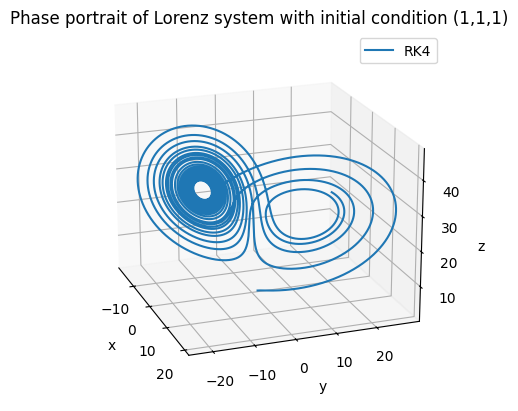

In [15]:

fig = plt.figure()
ax = fig.add_subplot(projection="3d")
ax.plot(x, y, z, label='RK4')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')
ax.set_title('Phase portrait of Lorenz system with initial condition (1,1,1)')
ax.azim = -20
ax.dist = 5
ax.elev = 20
plt.legend()
plt.show()

## Task 2.5

In [16]:
# Task 2.5

sigma = 10
beta = 8/3
rho = 28
t_start = 0
t_final = 20
h = 10**(-4)

epsilon = [0, 0.1, 10**(-5), 10**(-12)]
results = [] # the result of three apprximation

for i in epsilon:
    ics = (1+i, 1, 1)
    approx, x_vec = RK4_step(lorenz, t_start, t_final, h, ics)
    results.append(approx)



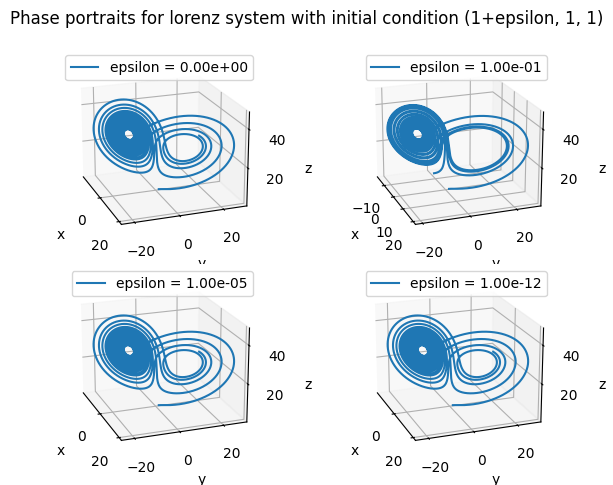

In [17]:
import matplotlib.pyplot as plt
fig = plt.figure()

for i in range(4):
    # ax[i] = fig.add_subplot(projection="3d")
    x, y, z = results[i].T
    ax = fig.add_subplot(int((len(results)+1.1)//2),2,i+1, projection="3d")
    ax.plot(x, y, z, label='epsilon = {:.2e}'.format((results[i][0,0]-1)))
    ax.azim = -20
    ax.dist = 5
    ax.elev = 20
    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_zlabel('z')
    ax.legend()
# set title for all
fig.suptitle('Phase portraits for lorenz system with initial condition (1+epsilon, 1, 1)')
plt.tight_layout()
plt.show()

## Task 2.5 (a)

The solutions have the same overall shapes. But they are not identical (especially for the one $e=10^{-1}$)

In [26]:
# we shall first compute the exact solution
sigma = 8/3
beta = 4
rho = 6
t_start = 0
t_final = 20
exact_h = 10**(-5)
ics = (1, 1, 1)

# find an accurate approximation of the solution
exact, _ = RK4_step(lorenz, t_start, t_final, exact_h, ics)

In [37]:

exact_adj = []

x_vec = timesteps(t_start, t_final, 10**(-4))

for i in range(len(x_vec)):
    # calculate the  appropriate index
    index = (x_vec[i]-x_vec[0])//(exact_h)
    exact_adj.append(exact[int(index)])


error = []
for i in range(len(results)):
    tmp = []
    for j in range(len(results[i])):
        tmp.append(np.linalg.norm(exact[j] - results[i][j]))
    error.append(tmp)
    

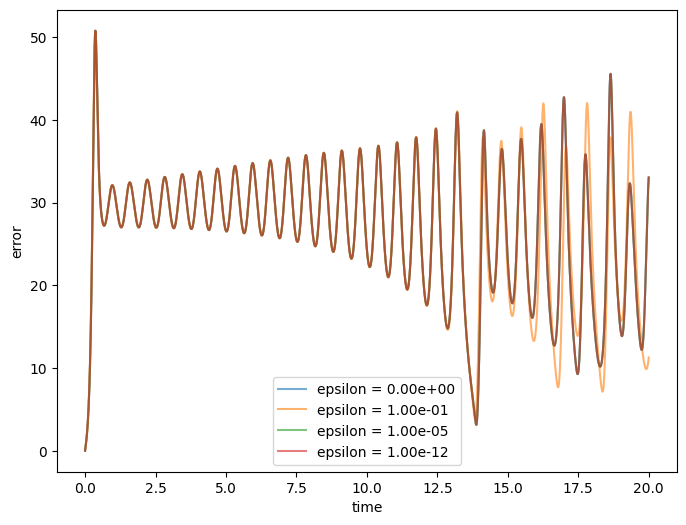

In [39]:
# plot the error vs timestep for each epsilon
plt.figure(figsize=(8, 6))
for i in range(len(error)):
    plt.plot(x_vec, error[i], label='epsilon = {:.2e}'.format((results[i][0,0]-1)), alpha=0.6)
plt.xlabel('time')
plt.ylabel('error')
plt.legend()
plt.show()


### Task 2.5 (b)

If the two initial conditions are very close, they do not necessarily stay close to each other all the time. However, them do seem may converge to the same critical point when $t \rightarrow \infty$

There is indeed an upper bound for $\mathcal{e}(t)$.  This implies that the two trajectories will never be too far away from each other. I.e., the critical points are stable.